In [100]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
from sklearn.preprocessing import MinMaxScaler

In [101]:
data = pd.read_csv('California.csv')

In [102]:
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-122.23,37.88,41,880,129.0,322,126,8.3252,NEAR BAY,452600
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,NEAR BAY,358500
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,NEAR BAY,352100
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,NEAR BAY,341300
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,NEAR BAY,342200


In [103]:
print(data.columns)
print(data.shape)

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'ocean_proximity', 'median_house_value'],
      dtype='object')
(20640, 10)


In [104]:
#checking for missing values
data.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
ocean_proximity         0
median_house_value      0
dtype: int64

In [105]:
data = data.dropna()
print(data.shape)

(20433, 10)


In [106]:
#check for duplicates
data.duplicated().sum()

0

In [107]:
#type of data
data.dtypes

longitude             float64
latitude              float64
housing_median_age      int64
total_rooms             int64
total_bedrooms        float64
population              int64
households              int64
median_income         float64
ocean_proximity        object
median_house_value      int64
dtype: object

In [108]:
#Target variable
data['median_house_value'].describe()

label = data['median_house_value']

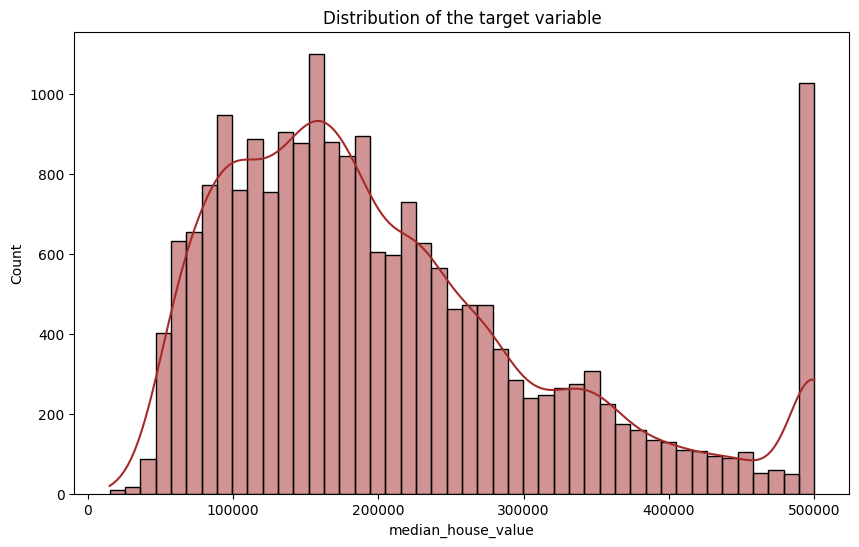

In [109]:
#label distribution
plt.figure(figsize=(10,6))
sns.histplot(label, kde=True, color='brown')
plt.title('Distribution of the target variable')
plt.show()


In [110]:
#numerical features
num_features = data.select_dtypes(include=[np.number])
num_features = num_features.drop(['median_house_value'], axis=1)

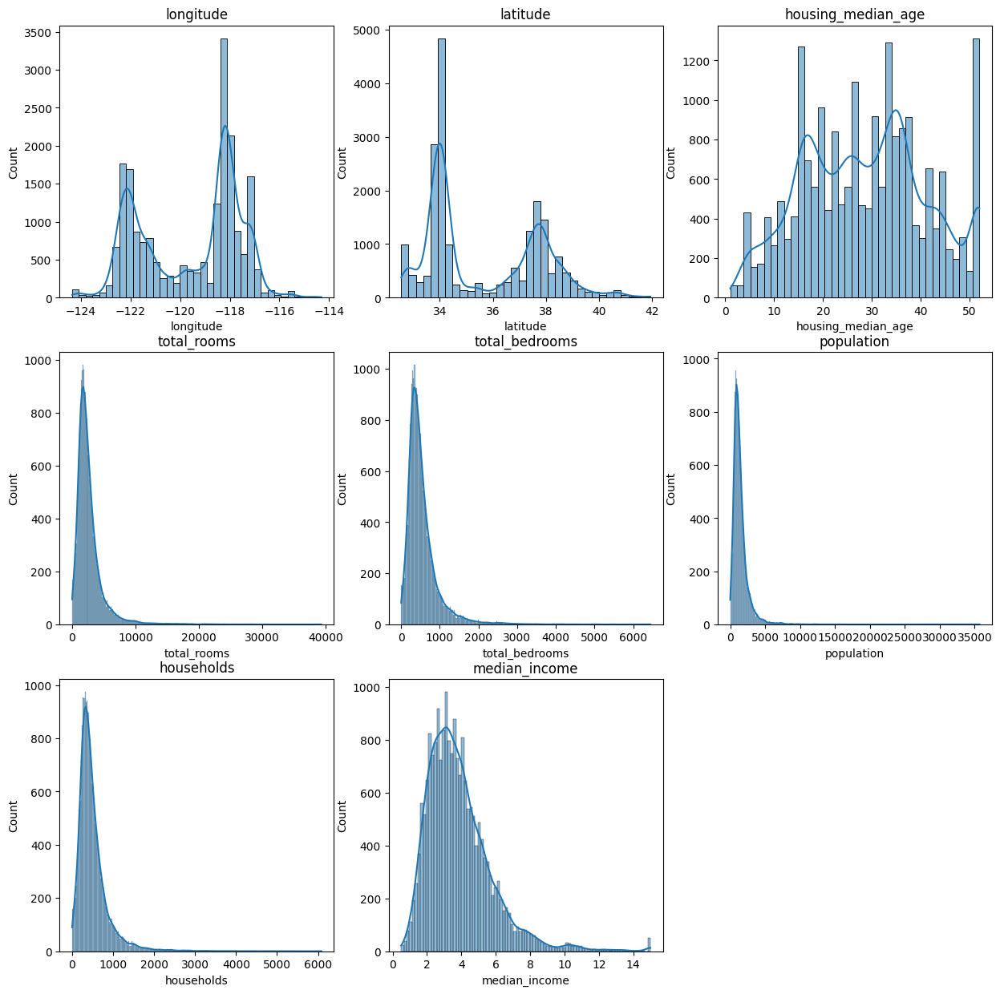

In [111]:
#numerical features distribution
plt.figure(figsize=(15,15))
for i in range(len(num_features.columns)):
    plt.subplot(3,3,i+1)
    sns.histplot(num_features.iloc[:,i], kde=True)
    plt.title(num_features.columns[i])

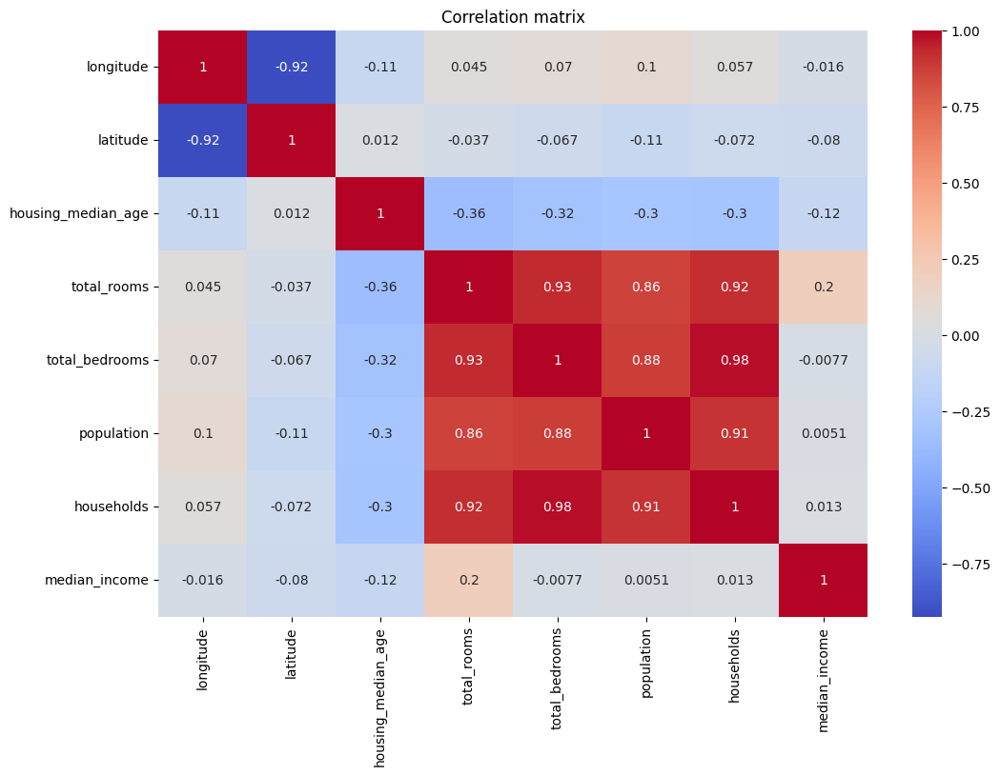

In [112]:
#correlation
correlation = num_features.corr()
plt.figure(figsize=(12,8))
sns.heatmap(correlation, annot=True, cmap='coolwarm')
plt.title('Correlation matrix')
plt.show()


In [113]:
data.shape

(20433, 10)

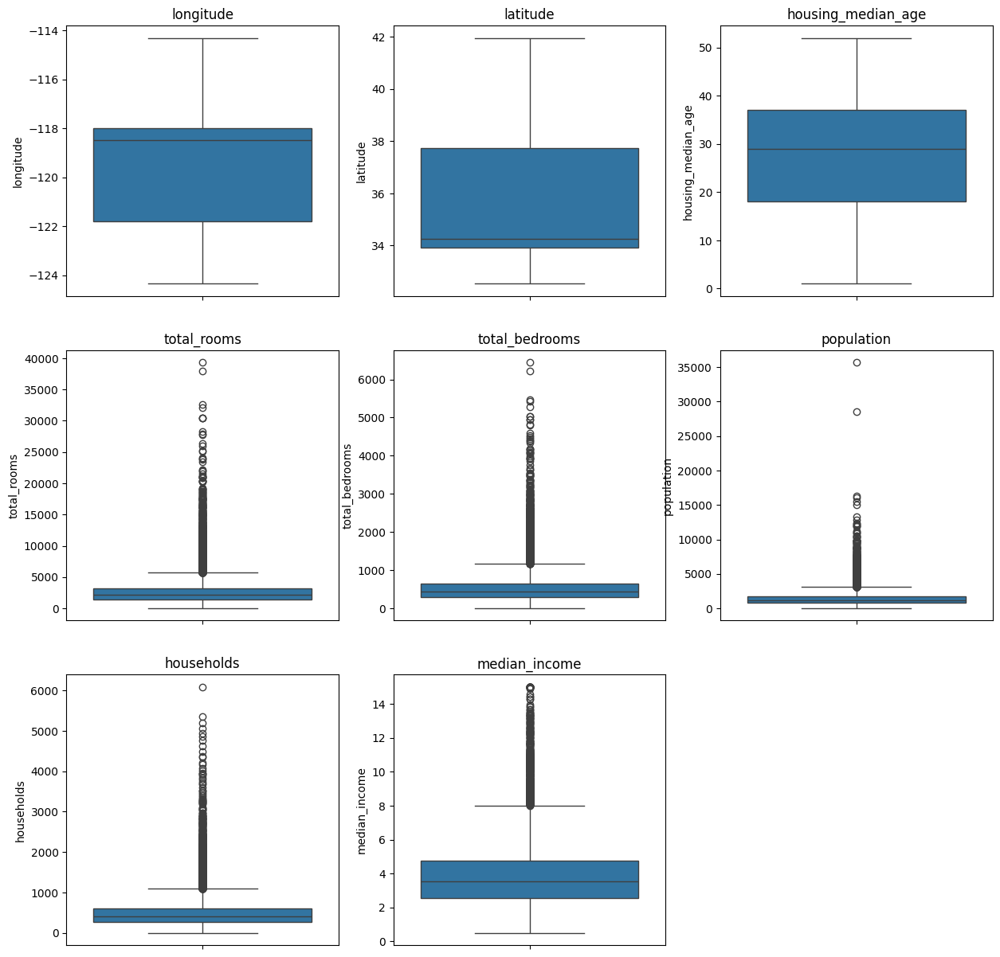

In [114]:
#boxplot
plt.figure(figsize=(15,15))
for i in range(len(num_features.columns)):
    plt.subplot(3,3,i+1)
    sns.boxplot(y=num_features.iloc[:,i])
    plt.title(num_features.columns[i])

plt.show()

In [115]:
#Categorical features distribution
data['ocean_proximity'].value_counts()


ocean_proximity
<1H OCEAN     9034
INLAND        6496
NEAR OCEAN    2628
NEAR BAY      2270
ISLAND           5
Name: count, dtype: int64

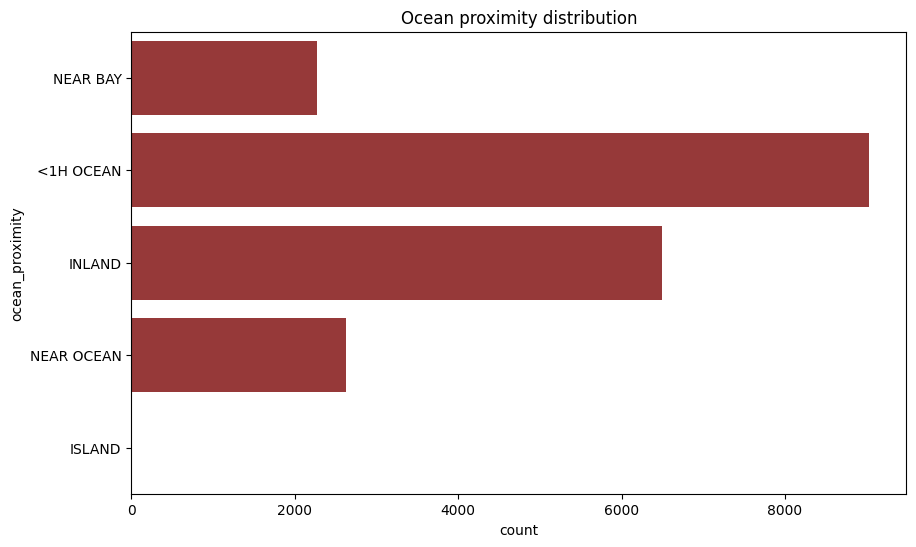

In [116]:
#Categorical features distribution
plt.figure(figsize=(10,6))
sns.countplot(data['ocean_proximity'], color='brown')
plt.title('Ocean proximity distribution')
plt.show()


In [118]:
#one hot encoding
data = pd.get_dummies(data, columns=['ocean_proximity'], drop_first=True)

In [117]:
#Feature engineering
data['rooms_per_household'] = data['total_rooms']/data['households']
data['bedrooms_per_room'] = data['total_bedrooms']/data['total_rooms']

In [119]:
#drop columns
data = data.drop(['total_rooms', 'total_bedrooms', 'households'], axis=1)

In [120]:
data.head()

,longitude,latitude,housing_median_age,population,median_income,median_house_value,rooms_per_household,bedrooms_per_room,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,-122.23,37.88,41,322,8.3252,452600,6.984127,0.146591,False,False,True,False
1,-122.22,37.86,21,2401,8.3014,358500,6.238137,0.155797,False,False,True,False
2,-122.24,37.85,52,496,7.2574,352100,8.288136,0.129516,False,False,True,False
3,-122.25,37.85,52,558,5.6431,341300,5.817352,0.184458,False,False,True,False
4,-122.25,37.85,52,565,3.8462,342200,6.281853,0.172096,False,False,True,False


In [123]:
#geo analysis
m = folium.Map(location=[36.7783, -119.4179], zoom_start=6)

marker_cluster = MarkerCluster().add_to(m)

for index, row in data.iterrows():
    folium.Marker([row['latitude'], row['longitude']], popup=row['median_house_value']).add_to(marker_cluster)

m

In [125]:
#remove outliers
def remove_outliers(data, column):
    q1 = data[column].quantile(0.25)
    q3 = data[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - (1.5 * iqr)
    upper_bound = q3 + (1.5 * iqr)
    data = data[(data[column] > lower_bound) & (data[column] < upper_bound)]
    return data

In [126]:
data = remove_outliers(data, 'median_house_value')

In [127]:
#export data
data.to_csv('California_cleaned.csv', index=False)